In [ ]:
!pip install scikit-gstat
!pip install geopandas
!pip install rasterio

     |████████████████████████████████| 2.1 MB 7.1 MB/s 
  Created wheel for scikit-gstat: filename=scikit_gstat-1.0.1-py3-none-any.whl size=703496 sha256=5e2caceea69bfa0d75868ecb3180f9290aba4db1b8e5ede39d1b2843d4ece733
  Stored in directory: /root/.cache/pip/wheels/0e/66/1b/692968c08959d21040075395a1e2e15ffd71823034691e1778
Successfully built scikit-gstat
     |████████████████████████████████| 1.0 MB 8.9 MB/s 
     |████████████████████████████████| 6.3 MB 48.7 MB/s 
     |████████████████████████████████| 16.7 MB 44.0 MB/s 
     |████████████████████████████████| 19.3 MB 194 kB/s 


In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np

# We import the folium library to make interactive maps
import folium

# We need to import branca.colormap to give pretty colors to our points according 
# to groundwater table elevation
import branca.colormap as cm

# We need requests to get our dataset and zipfile to unzip our dataset
import requests
import zipfile

%matplotlib inline

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving Turf202108071556.zip to Turf202108071556.zip


In [ ]:
'''url = "https://github.com/guiattard/PythonForGeosciences/raw/master/geostatistics-applied-to-hydrogeology-with-scikit-gstat/hydraulic-head-lyon-sample.zip"
file = "hydraulic-head-lyon-sample.zip"
# Command to donwload the file at the given url
r = requests.get(url)

# Then we open the file
#open(file, 'wb').write(r.content)'''

import io, os

for key, value in uploaded.items():
  file = key

# We extract the content of the .zip file
with zipfile.ZipFile(file, 'r') as unzip: unzip.extractall("./dat")


# we finally read the shapefile and make some cleaning
gdf = gpd.read_file("./dat/S202108071556.shp")

#  Adding x & y fields of geometry
x = pd.DataFrame(gdf["geometry"].x)
y = pd.DataFrame(gdf["geometry"].y)

gdf = pd.concat([gdf, x, ], axis = 1)
gdf = gdf.rename(columns = {0 : "x"})
gdf = pd.concat([gdf, y, ], axis = 1)
gdf = gdf.rename(columns = {0 : "y"})
gdf.head()

,OBJECTID,Sensor,SDate,STime,GroundTemp,Salinity,Dielectric,Moisture,Latitude,Longtitude,Type,SenNo,DateTime,UDT,Mos,DDLat,DDLon,ORIG_OID,geometry,x,y
0,1,G1A0000497,20210806,1899-12-30,10,0.01,6,13,-41.139687,175.012009,Bent Grass,497,20210806165900,2021/08/06 16:59,13,41.13968700S,175.01200900E,1,POINT (333155.828 5443831.477),333155.8282,5.443831e+06
1,2,G1A0000381,20210807,1899-12-30,11,0.01,13,27,-41.138222,175.017807,Creeping Bentgrass,381,20210807082400,2021/08/07 08:24,27,41.13822200S,175.01780700E,2,POINT (333638.754 5444005.219),333638.7544,5.444005e+06
2,3,G1A0000484,20210807,1899-12-30,11,0.01,9,19,-41.138744,175.010864,Bent Grass,484,20210807084000,2021/08/07 08:40,19,41.13874400S,175.01086400E,4,POINT (333057.336 5443933.975),333057.3355,5.443934e+06
3,4,G1A0000353,20210807,1899-12-30,12,0.01,11,24,-41.139885,175.012894,Creeping Bentgrass,353,20210807085500,2021/08/07 08:55,24,41.13988500S,175.01289400E,5,POINT (333230.609 5443811.190),333230.6086,5.443811e+06
4,5,G1A0000382,20210807,1899-12-30,12,0,15,31,-41.138042,175.017548,Creeping Bentgrass,382,20210807090000,2021/08/07 09:00,31,41.13804200S,175.01754800E,6,POINT (333616.561 5444024.708),333616.5609,5.444025e+06


In [ ]:
loc_x, loc_y, sname = gdf['Latitude'], gdf['Longtitude'], gdf['Sensor']
loc_res = pd.concat([loc_x,loc_y], axis = 1)
loc_res = [loc_res.values]
sensor_location = sensors = []
for x in loc_res:
  for y in x:
      # print(list(y))
      sensor_location.append(list(y))
# resv = tuple(resv)
sensor_location


sname = [sname.values]
for name in sname:
#   # for x in name:
    # print(name)
    sensors = list(name)
sensors
# sname

['G1A0000497',
 'G1A0000381',
 'G1A0000484',
 'G1A0000353',
 'G1A0000382',
 'G1A0000391',
 'G1A0000518',
 'G1A0000347',
 'G1A0000375',
 'G1A0000384',
 'G1A0000460',
 'G1A0000474',
 'G1A0000440',
 'G1A0000385',
 'G1A0000345',
 'G1A0000356',
 'G1A0000378',
 'G1A0000362',
 'G1A0000379',
 'G1A0000472',
 'G1A0000372',
 'G1A0000361',
 'G1A0000465',
 'G1A0000486',
 'G1A0000338',
 'G1A0000354',
 'G1A0000444',
 'G1A0000485',
 'G1A0000445',
 'G1A0000443',
 'G1A0000466',
 'G1A0000495',
 'G1A0000333',
 'G1A0000483',
 'G1A0000500',
 'G1A0000498']

In [ ]:
import os

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving RW_Area.zip to RW_Area.zip


In [ ]:
'''# The url where we can fide the shapefile
url_dep = "http://osm13.openstreetmap.fr/~cquest/openfla/export/departements-20180101-shp.zip"

# The name of the zip file
file_dep = "departements-20180101-shp.zip"

# Command to donwload the file at the given url
r = requests.get(url_dep)

# Then we open the file
open(file_dep, 'wb').write(r.content)'''

import io, os

for key, value in uploaded.items():
  file_dep = key
  file = key

# We extract the content of the .zip file
with zipfile.ZipFile(file_dep, 'r') as unzip: unzip.extractall("./dat")

# we finally read the shapefile and make some cleaning
dep = gpd.read_file("./dat/RW_Ext_Area.shp")

# We remove the zipfile
os.remove(file_dep)

# we print the head of our geodataframe
dep.head()

,Id,geometry
0,0,"POLYGON ((334171.529 5445074.898, 334318.861 5..."


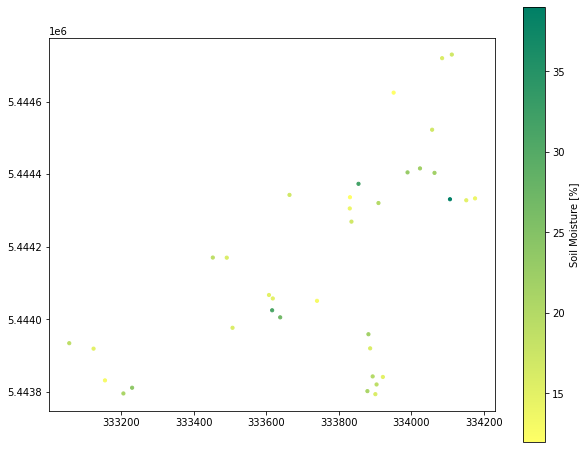

In [ ]:
# We plot the result
fig, ax = plt.subplots(figsize=(10,8))

# We add the location of sensors
gdf.plot(ax = ax, cmap = "summer_r",
            column = "Mos",
            markersize=10, 
            legend = True,
            legend_kwds={'label': "Soil Moisture [%]"})

plt.show()

In [ ]:
# We build our map focusing on our site and specifying the zoom start
mymap = folium.Map(location=[gdf.Latitude.mean(), gdf.Longtitude.mean()], 
                   zoom_start=12,
                  #  show=True, 
                   control_scale = True
                   )

# Add the geological map of France
url = 'http://geoservices.brgm.fr/geologie'
layer1 = 'GEOLOGIE'
folium.WmsTileLayer(url, layer1, attr = 'BRGM', 
                    # name = 'Geological map', 
                    show=True).add_to(mymap)

# Add a feature group to add borehole with hydraulic head measurements
fg_gwt = folium.FeatureGroup(name = 'Hydraulic head', show = True)
mymap.add_child(fg_gwt)

colormap = cm.LinearColormap(colors=['orange', 'yellow', 'green', 'lightblue', 'blue'], 
                             index=[gdf["Mos"].quantile(0),
                                    gdf["Mos"].quantile(0.25),
                                    gdf["Mos"].quantile(0.5),
                                    gdf["Mos"].quantile(0.75),
                                    gdf["Mos"].quantile(1)], 
                             vmin=gdf["Mos"].quantile(0),
                             vmax=gdf["Mos"].quantile(1))

# We add the caption of our colormap
colormap.caption = 'Soil Moisture [%]'

# We add all points of our dataset
for i, h in zip(gdf.index.values, gdf.Mos.values):
    dfi = folium.CircleMarker(
        location = [gdf.at[i,'Latitude'], gdf.at[i,'Longtitude']],
        popup =str(round(h,2)) + " %",
        radius= 7,
        fill=True,
        fill_opacity=0.7,
        color = colormap(h),
        fill_color = colormap(h))
    dfi.add_to(fg_gwt)                

mymap.add_child(colormap)
mymap.add_child(folium.map.LayerControl(collapsed=True))

In [ ]:
import plotly.express as px

# create the scatter_mapbox
fig = px.scatter_mapbox(gdf, 
    lat='Latitude', lon='Longtitude', zoom=15, height=450,  
    hover_data=['Mos'], color='Mos'
)

# use a base-style that does not need a MAPBOX token
fig.update_layout(
    mapbox_style='stamen-terrain',
    mapbox=dict(pitch=45),
)

# get rid of margins
fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving RW_Area.zip to RW_Area.zip


In [ ]:
'''url = "https://github.com/guiattard/PythonForGeosciences/raw/master/geostatistics-applied-to-hydrogeology-with-scikit-gstat/gw-body.zip"
file = "gw-body.zip"
# Command to donwload the file at the given url
r = requests.get(url)

# Then we open the file
open(file, 'wb').write(r.content)'''

#import io, os

#for key, value in uploaded.items():
#  file = key
#  print(key)

# We extract the content of the .zip file
#with zipfile.ZipFile(file, 'r') as unzip: unzip.extractall("./dat")

# we finally read the shapefile
area = gpd.read_file("./dat/RW_Ext_Area.shp")

area.head()

,Id,geometry
0,0,"POLYGON ((334171.529 5445074.898, 334318.861 5..."


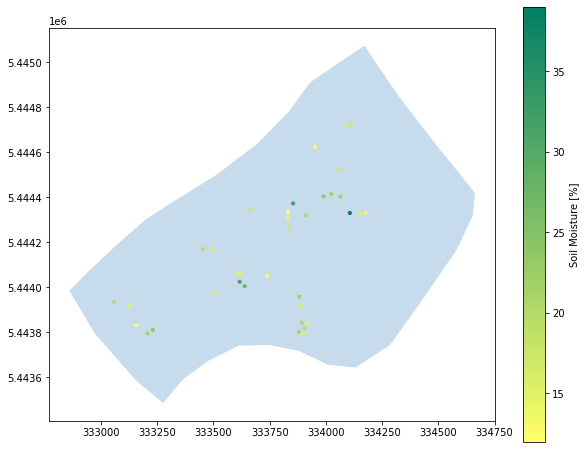

In [ ]:
# Spatial join
#gdf = gpd.sjoin(gdf, area, op = "within")

# PLot the results
fig, ax = plt.subplots(figsize=(10,8))

area.plot(ax = ax, alpha = 0.25)

# We add the location of sensors in the turf area
gdf.plot(ax = ax, cmap = "summer_r",
            column = "Mos",
            markersize=10, 
            legend = True,
            legend_kwds={'label': "Soil Moisture [%]"})
plt.show()

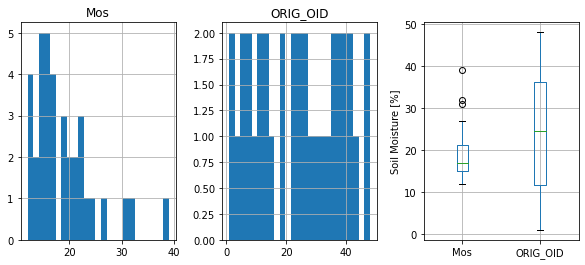

In [ ]:
fig, axs = plt.subplots(1,3, figsize=(10,4))
ax = axs[0:2]
#gdf[['hh', 'z']].hist(ax = ax, bins=25)
gdf[['Mos', 'ORIG_OID']].hist(ax = ax, bins=25)

ax = axs[2]
ax.set_ylabel('Soil Moisture [%]')
#gdf[['hh', 'z']].boxplot(ax = ax)
gdf[['Mos', 'ORIG_OID']].boxplot(ax = ax)

plt.show()

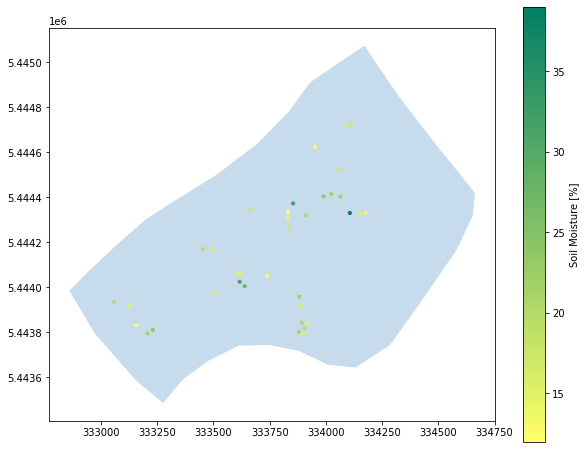

In [ ]:
gdf = gdf[gdf.Mos > 5]

# PLot the results
fig, ax = plt.subplots(figsize=(10,8))

area.plot(ax = ax, alpha = 0.25)

# We add the location of sensors in the turf area
gdf.plot(ax = ax, cmap = "summer_r",
            column = "Mos",
            markersize=10, 
            legend = True,
            legend_kwds={'label': "Soil Moisture [%]"})
plt.show()

In [ ]:
# We determine xmin, xmax, ymin and ymax from our dataset:
#xv = gdf['x'].values
#yv = gdf['y'].values

#xmin, xmax = min(xv), max(xv)
#ymin, ymax = min(yv), max(yv)

xmin, xmax = float(area.bounds.minx), float(area.bounds.maxx)
ymin, ymax = float(area.bounds.miny), float(area.bounds.maxy)



# We determine the resolution in x direction:
res_x = 250
# We determine the resolution in y direction
# based on res_x to make a regular grid:
res_y = int((ymax - ymin)*res_x/(xmax - xmin))

# We build the grid:
xx,yy = np.mgrid[xmin:xmax:complex(res_x), 
                 ymin:ymax:complex(res_y)]

print('X coordinates:\n', xx[:5,:5].round(1))
print('Y coordinates:\n', yy[:5,:5].round(1))

X coordinates:
 [[332858.7 332858.7 332858.7 332858.7 332858.7]
 [332865.9 332865.9 332865.9 332865.9 332865.9]
 [332873.2 332873.2 332873.2 332873.2 332873.2]
 [332880.4 332880.4 332880.4 332880.4 332880.4]
 [332887.6 332887.6 332887.6 332887.6 332887.6]]
Y coordinates:
 [[5443485.2 5443492.5 5443499.7 5443507.  5443514.2]
 [5443485.2 5443492.5 5443499.7 5443507.  5443514.2]
 [5443485.2 5443492.5 5443499.7 5443507.  5443514.2]
 [5443485.2 5443492.5 5443499.7 5443507.  5443514.2]
 [5443485.2 5443492.5 5443499.7 5443507.  5443514.2]]


In [ ]:
from scipy.interpolate import griddata

# We put the x/y coordinates of our dataset into an array
points = np.asanyarray(gdf[['x', 'y']])

# We put our moisture values of our dataset into list of the same dimension
values = gdf['Mos'].values

# We make the linear interpolation
MOS_LINEAR = griddata(points, values, (xx, yy), method='linear')

# We make the cubic interpolation
MOS_CUBIC = griddata(points, values, (xx, yy), method='cubic')

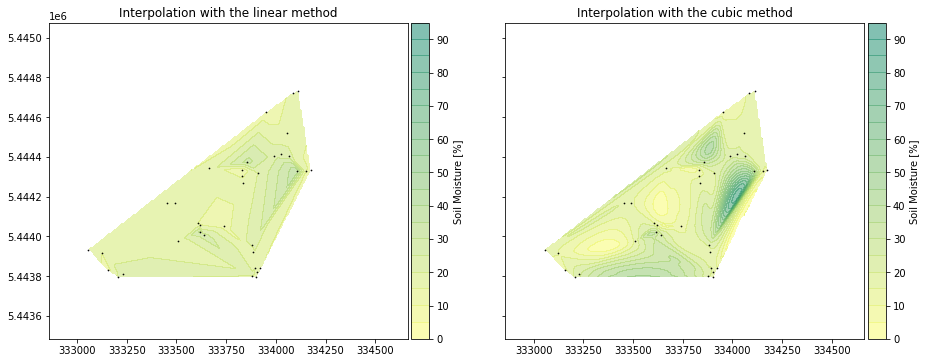

In [ ]:
fig, axs = plt.subplots(1,2, figsize=(15, 10), sharey=True)

ax =axs[0]
# We plot contour fringes based on our linear griddata interpolation
ctr_linear = ax.contourf(xx, 
                         yy, 
                         MOS_LINEAR,
                         range(0,100,5),
                         cmap = "summer_r", 
                         alpha = 0.5)

# Some parameters to make a pretty fig:
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(ctr_linear, cax=cax, label = 'Soil Moisture [%]')
ax.set_title("Interpolation with the linear method")

# We add the location of points of our dataset
gdf.plot(ax = ax, c = "black", marker= '.', markersize = 2)

ax =axs[1]
# We plot contour fringes based on our cubic griddata interpolation
ctr_cubic = ax.contourf(xx, 
                        yy, 
                        MOS_CUBIC,
                        range(0,100,5),
                        cmap = "summer_r",
                        alpha = 0.5)

# Some parameters to make a pretty fig:
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(ctr_cubic, cax=cax, label = 'Soil Moisture [%]')

ax.set_title("Interpolation with the cubic method")

# We add the location of points of our dataset
gdf.plot(ax = ax, c = "black", marker= '.', markersize = 2)

plt.show()

In [ ]:
from skgstat import Variogram, OrdinaryKriging, plotting

# to have nicer plots, we switch to plotly backend
plotting.backend('plotly')

In [ ]:
V = Variogram(list(zip(gdf.x, gdf.y)), 
              gdf.Mos,
              normalize = False,
              model = "spherical",
              use_nugget = True,
              n_lags=25, 
              maxlag=1700)

fig = V.plot()

In [ ]:
V.fit_sigma = 'linear'
fig1 = V.plot(show=False)
fig1.update_layout(title='Linear Weights', width = 1000)

V.fit_sigma = 'sqrt'
fig2 = V.plot(show=False)
fig2.update_layout(title='Sqrt-decrease Weights', width = 1000)

fig1.show()
fig2.show()

In [ ]:
%%time
# We build our kriging model:
ok =  OrdinaryKriging(V, min_points=5, max_points=15, mode='exact',n_jobs=1)

# We calculate the moisture on our regular grid,
# and we make the result in a good shape
Mos_hat = ok.transform(xx.flatten(), yy.flatten()).reshape(xx.shape)

# We calculate the kriging error on our grid:
s2 = ok.sigma.reshape(xx.shape)

CPU times: user 31.8 s, sys: 25.1 s, total: 56.9 s
Wall time: 29.4 s


In [ ]:
%%time
len(yy.flatten())

CPU times: user 0 ns, sys: 514 µs, total: 514 µs
Wall time: 528 µs


55000

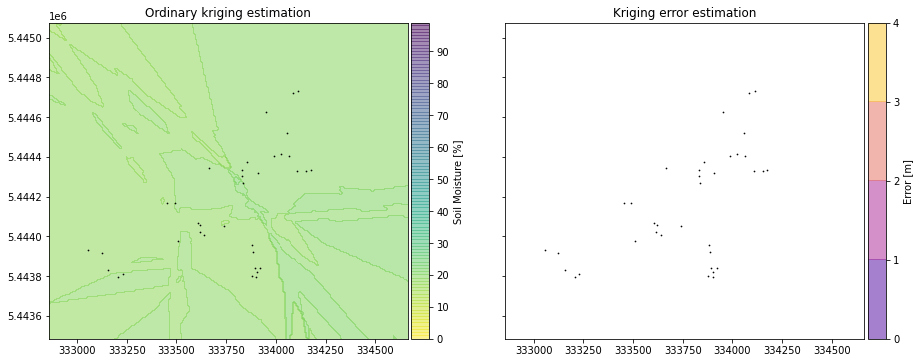

In [ ]:
fig, axs = plt.subplots(1, 2 ,figsize=(15, 10), sharey=True)

ax = axs[0]

# Contour fringes of the kriging process:
ctr_hh = ax.contourf(xx, yy, Mos_hat,
                     range(0,100,1),
                     cmap = "viridis_r", 
                     alpha = 0.5)

ax.set_title("Ordinary kriging estimation")

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(ctr_hh, cax=cax, label = 'Soil Moisture [%]')

# We add the location of points of our dataset
gdf.plot(ax = ax, c = "black", marker= '.', markersize = 2)

ax = axs[1]

# Contour fringes of the kriging error:
ctr_err = ax.contourf(xx, yy, s2,
                      range(0,5,1),
                      cmap = "plasma",
                      alpha = 0.5)
ax.set_title("Kriging error estimation")

# We add the location of points of our dataset
gdf.plot(ax = ax, c = "black", marker= '.', markersize = 2)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(ctr_err, cax=cax, label = 'Error [m]')

plt.show()

In [ ]:
from shapely.geometry import Point

# We initiale a mask with 0 everywhere with the similar shape as earlier
maskin = xx - xx

# In this mask, we assign True if the point is inside the groundwater body
# and we assign False if the point is outside the groundwater body
for i in range(maskin.shape[0]):
    for j in range(maskin.shape[1]):
        xi = xx[i][j]
        yj = yy[i][j]
        if Point(xi, yj).within(area["geometry"][0]):
            maskin[i, j] = 0
        else:
            maskin[i, j] = 1
            
# We apply our mask to previous calculated arrays:
Mos_ma = np.ma.masked_array(Mos_hat, maskin)
s2_ma = np.ma.masked_array(s2, maskin)

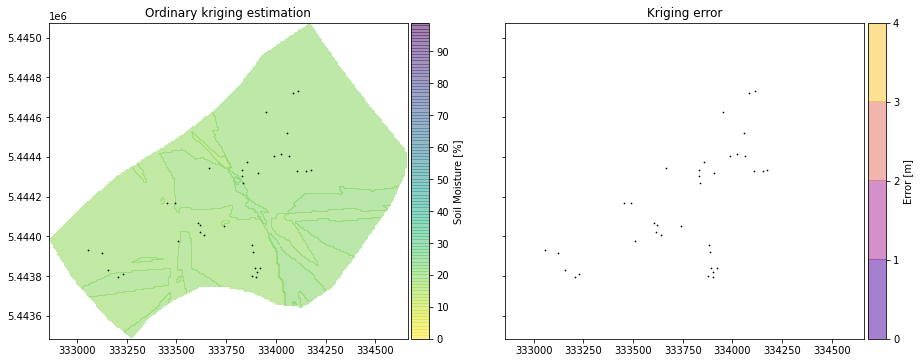

In [ ]:
# We plot the results:
fig, axs = plt.subplots(1, 2 ,figsize=(15, 10), sharey=True)

ax = axs[0]
# Contour fringes of the kriging process:
ctr_hh = ax.contourf(xx, yy, Mos_ma, range(0, 100, 1),
                     cmap = "viridis_r", 
                     alpha = 0.5)

ax.set_title("Ordinary kriging estimation")

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(ctr_hh, cax=cax, label = 'Soil Moisture [%]')

# We add the location of points of our dataset
gdf.plot(ax = ax, c = "black", marker= '.', markersize = 2)

ax = axs[1]

# Contour fringes of the kriging error:
ctr_err = ax.contourf(xx, yy, s2_ma,
                      range(0,5,1),
                      cmap = "plasma",
                      alpha = 0.5)

ax.set_title("Kriging error")

# We add the location of points of our dataset
gdf.plot(ax = ax, c = "black", marker= '.', markersize = 2)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(ctr_err, cax=cax, label = 'Error [m]')

plt.show()

In [ ]:
df_ok = pd.DataFrame({'x': xx.flatten(),
                      'y': yy.flatten(),
                      'Mos_k': Mos_ma.flatten(),
                      's2': s2_ma.flatten()})

# We remove points without values (in the False part of our mask)
df_ok = df_ok.dropna()

# We transform our df into a geodataframe
export = gpd.GeoDataFrame(df_ok, 
                          geometry=gpd.points_from_xy(df_ok.x, df_ok.y))

export.head()

,x,y,Mos_k,s2,geometry
288,332865.902320,5.443979e+06,18.533333,39.334162,POINT (332865.902 5443978.802)
289,332865.902320,5.443986e+06,18.533333,39.334162,POINT (332865.902 5443986.061)
506,332873.150722,5.443964e+06,18.866667,39.334162,POINT (332873.151 5443964.284)
507,332873.150722,5.443972e+06,18.533333,39.334162,POINT (332873.151 5443971.543)
508,332873.150722,5.443979e+06,18.533333,39.334162,POINT (332873.151 5443978.802)


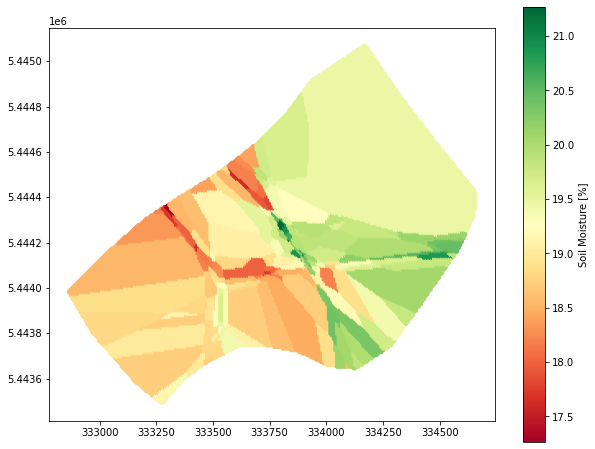

In [ ]:
fig, ax = plt.subplots(figsize=(10,8))

# We add the location of moisture
export.plot(ax = ax, cmap = "RdYlGn",
            column = "Mos_k",
            markersize=10, 
            legend = True,
            legend_kwds={'label': "Soil Moisture [%]"}
            )

# plt.show()
plt.savefig('out.jpg', bbox_inches='tight', pad_inches=0)


In [ ]:
export.to_file('my_kriging_export.shp')

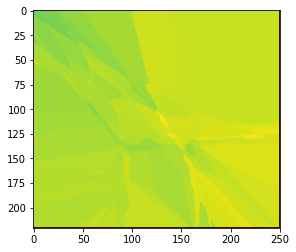

In [ ]:
from osgeo import gdal, osr

# we determine the pixel size in x and y directions.
dx = abs(xmax - xmin)/res_x
dy = abs(ymax - ymin)/res_y

# we determine paramaters associated to our image
# top left x 
# w-e pixel resolution
# rotation, 0 if image is "north up"
# top left y
# n-s pixel resolution
params =(xmin - dx/2, dx, 0, ymax + dy/2, 0, -dy)

# the name of our geoTIFF
tif_name = "my_kriging_geotiff.tif"
            
# Create/Open the raster
output_raster = gdal.GetDriverByName('GTiff').Create(tif_name, res_x+1, res_y+1, 1 ,gdal.GDT_Float32)

# Specify its coordinates
output_raster.SetGeoTransform(params)

# Establish its coordinate encoding:
srs = osr.SpatialReference() 

# Our projection system is specified:
srs.ImportFromEPSG(32760)    

# Exports the coordinate system to the file
output_raster.SetProjection(srs.ExportToWkt()) 

# Writes my array to the raster after some transformation due to the resulting shape of the kriging:
output_raster.GetRasterBand(1).WriteArray(np.transpose(np.flip(Mos_hat[::-1]))) 
output_raster.GetRasterBand(1).SetNoDataValue(0) 
output_raster.FlushCache()

band = output_raster.GetRasterBand(1)
colors = gdal.ColorTable()
colors.CreateColorRamp(0, (229, 245, 249), 127, (153, 216, 201))
colors.CreateColorRamp(127, (153, 216, 201), 254, (44, 162, 95))
band.SetRasterColorTable(colors)
band.SetRasterColorInterpretation(gdal.GCI_PaletteIndex)

# Uncomment below if you want to preview the result:
import rasterio
src = rasterio.open(tif_name)
plt.imshow(src.read(1))

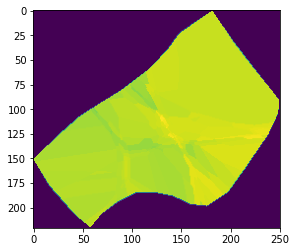

In [ ]:
import fiona
import rasterio
import rasterio.mask

# For shape geometry
with fiona.open("./dat/RW_Ext_Area.shp", "r") as shapefile:
    shapes = [feature["geometry"] for feature in shapefile]

# For masking TIFF Image
with rasterio.open(tif_name) as src:
    out_image, out_transform = rasterio.mask.mask(src, shapes, crop=True)
    out_meta = src.meta

out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})

with rasterio.open("my_kriging_geotiff_masked.tif", "w", **out_meta) as dest:
    dest.write(out_image)

src = rasterio.open("my_kriging_geotiff_masked.tif")
plt.imshow(src.read(1))

In [ ]:
from folium import raster_layers

a1 = area.to_crs(4326)

In [ ]:
import matplotlib.cm as cm
def get_color(x):
    decimals = 2
    x = np.around(x, decimals=decimals)
    ls = np.linspace(0,255,int(159.688**decimals)+1)
    if 0 <= x <= 255:
        return cm.get_cmap('viridis')(ls)[np.argwhere(ls==x)]
    elif x==-128:
        return (0, 0, 0, 0)
    else:
        raise ValueError()

In [ ]:
cm.viridis(4)

(0.272594, 0.025563, 0.353093, 1.0)

In [ ]:
# transferring geo information to jpg file
from osgeo import gdal
    
options_list = [
    '-ot Byte',
    '-of JPEG',
    '-b 1',
    '-scale'
]           

options_string = " ".join(options_list)
    
gdal.Translate(
    'save.jpg',
    'my_kriging_geotiff_masked.tif',
    options=options_string
)

<osgeo.gdal.Dataset; proxy of <Swig Object of type 'GDALDatasetShadow *' at 0x7f8e832abf90> >

In [ ]:
# boundary of the image on the map
# xv = gdf['Longtitude'].values
# yv = gdf['Latitude'].values

# xmin, xmax = min(xv), max(xv)
# ymin, ymax = min(yv), max(yv)
# min_lon = 175.0082110247929
# max_lon = 175.03267289847093
# min_lat = -41.13961302242926
# max_lat = -41.13253510810759

# -41.13961302242926, 175.03267289847093
# -41.13253510810759, 175.0082110247929
xmin, xmax = float(a1.bounds.minx), float(a1.bounds.maxx)
ymin, ymax = float(a1.bounds.miny), float(a1.bounds.maxy)

# create the map
map_ = folium.Map(location=[-41.13557374107402, 175.02147179428562],
                   zoom_start = 14)
# folium.Marker([-41.13557374107402, 175.02147179428562], popup="<i>Wellington Golf Club</i>").add_to(map_)

data = plt.imread("/content/my_kriging_geotiff_masked.tif").astype(float)
# Overlay the image
# map_.add_child(raster_layers.ImageOverlay(data, opacity=0.3, \
#         bounds =[[min_lat,min_lon ], [max_lat, max_lon]]))
map_.add_child(raster_layers.ImageOverlay(data, opacity=0.5, \
         bounds =[[ymin,xmin ], [ymax, xmax]], ))

for loc, name in zip(sensor_location, sensors):
# folium.vector_layers.Circle(([-41.13557374107402, 175.02147179428562]), radius=1, popup=None, tooltip=None).add_to(map_)
  folium.vector_layers.Circle(tuple(loc), radius=1, popup=name, tooltip=None).add_to(map_)


map_

In [ ]:
def colorize(array, cmap='rainbow'):
    normed_data = (array - array.min()) / (array.max() - array.min())
    cm = plt.cm.get_cmap(cmap)
    return cm(normed_data)

colored_data = colorize(data, cmap='rainbow')

In [ ]:
# boundary of the image on the map
# xv = gdf['Longtitude'].values
# yv = gdf['Latitude'].values

# xmin, xmax = min(xv), max(xv)
# ymin, ymax = min(yv), max(yv)
# min_lon = 175.0082110247929
# max_lon = 175.03267289847093
# min_lat = -41.13961302242926
# max_lat = -41.13253510810759

# -41.13961302242926, 175.03267289847093
# -41.13253510810759, 175.0082110247929
xmin, xmax = float(a1.bounds.minx), float(a1.bounds.maxx)
ymin, ymax = float(a1.bounds.miny), float(a1.bounds.maxy)

# create the map
map_ = folium.Map(location=[-41.13557374107402, 175.02147179428562],
                   zoom_start = 14)
folium.Marker([-41.13557374107402, 175.02147179428562], popup="<i>Wellington Golf Club</i>").add_to(map_)
# read in png file to numpy array
data = plt.imread("/content/my_kriging_geotiff_masked.tif").astype(float)

def colorize(array, cmap='rainbow'):
    normed_data = (array - array.min()) / (array.max() - array.min())
    cm = plt.cm.get_cmap(cmap)
    return cm(normed_data)

colored_data = colorize(data, cmap='rainbow')

# Overlay the image
# map_.add_child(raster_layers.ImageOverlay(data, opacity=0.3, \
#         bounds =[[min_lat,min_lon ], [max_lat, max_lon]]))
map_.add_child(raster_layers.ImageOverlay(colored_data, opacity=1.0, \
         bounds =[[ymin,xmin ], [ymax, xmax]], ))
map_

ValueError: ignored

In [ ]:
type(data)

numpy.ndarray

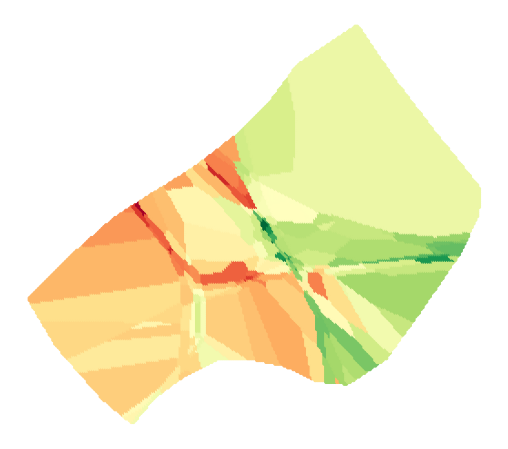

In [ ]:
fig, ax = plt.subplots(figsize=(10,8))

# We add the location of borehole with hydraulic head
export.plot(ax = ax, cmap = "RdYlGn",
            column = "Mos_k",
            markersize=10, 
            legend = False,
            #legend_kwds={'label': "Soil Moisture [%]"}
            )
ax.axis('off')
#plt.show()
plt.savefig('turf1.png')

In [ ]:
from osgeo import gdal
    
options_list = [
    '-ot Byte',
    '-of PNG',
    '-b 1',
    '-scale'
]           

options_string = " ".join(options_list)
    
gdal.Translate(
    'save.png',
    'my_kriging_geotiff_masked.tif',
    options=options_string
)

<osgeo.gdal.Dataset; proxy of <Swig Object of type 'GDALDatasetShadow *' at 0x7f8e82169900> >

In [ ]:
from PIL import Image

def convertImage():
	img = Image.open("./turf1.png")
	img = img.convert("RGBA")

	datas = img.getdata()

	newData = []

	for item in datas:
		if item[0] == 255 and item[1] == 255 and item[2] == 255:
			newData.append((255, 255, 255, 0))
		else:
			newData.append(item)

	img.putdata(newData)
	img.save("./New.png", "PNG")
	print("Successful")

convertImage()

Successful


In [ ]:
xmin, xmax = float(a1.bounds.minx), float(a1.bounds.maxx)
ymin, ymax = float(a1.bounds.miny), float(a1.bounds.maxy)
mymap = folium.Map(location=[-41.138690999999994, 175.020691], 
                   zoom_start=16,
                   control_scale = True)

url = 'https://basemaps.linz.govt.nz/v1/tiles/aerial/EPSG:3857/{z}/{x}/{y}.webp?api=c01ffqh100anh02ns9b4z5ebs0b'
layer1 = 'LINZ Basemaps Service'
folium.WmsTileLayer(url, layer1, attr = 'BRGM', show=True).add_to(mymap)
data1 = plt.imread("/content/New.png").astype(float)

mymap.add_child(raster_layers.ImageOverlay(data1, opacity=0.5, \
         bounds =[[ymin,xmin ], [ymax, xmax]]))
# for loc, name in zip(sensor_location, sensors):
folium.vector_layers.Circle(([-41.13557374107402, 175.02147179428562]), radius=1, popup=None, tooltip=None).add_to(map_)
  # folium.vector_layers.Circle(tuple(loc), radius=1, popup=name, tooltip=None).add_to(mymap)
mymap.save('heatmap.html')
mymap

In [ ]:
# boundary of the image on the map
# xv = gdf['Longtitude'].values
# yv = gdf['Latitude'].values

# xmin, xmax = min(xv), max(xv)
# ymin, ymax = min(yv), max(yv)
# min_lon = 175.0082110247929
# max_lon = 175.03267289847093
# min_lat = -41.13961302242926
# max_lat = -41.13253510810759

# -41.13961302242926, 175.03267289847093
# -41.13253510810759, 175.0082110247929
xmin, xmax = float(a1.bounds.minx), float(a1.bounds.maxx)
ymin, ymax = float(a1.bounds.miny), float(a1.bounds.maxy)

# create the map
map_ = folium.Map(location=[-41.13557374107402, 175.02147179428562],
                   zoom_start = 14)
folium.Marker([-41.13557374107402, 175.02147179428562], popup="<i>Wellington Golf Club</i>").add_to(map_)

# data = plt.imread("/content/New1.png").astype(float)
# Overlay the image
# map_.add_child(raster_layers.ImageOverlay(data, opacity=0.3, \
#         bounds =[[min_lat,min_lon ], [max_lat, max_lon]]))
data1 = plt.imread("/content/New.png").astype(float)
# map_.add_child(raster_layers.ImageOverlay(data, opacity=0.8, \
#          bounds =[[ymin,xmin ], [ymax, xmax]]))
map_.add_child(raster_layers.ImageOverlay(data1, opacity=0.8, \
         bounds =[[ymin,xmin ], [ymax, xmax]]))
map_

In [ ]:
export
newdf = export.set_crs("EPSG:32760")
newdf = newdf.to_crs("EPSG:4326")
newdf
#  Adding x & y fields of geometry
x = pd.DataFrame(newdf["geometry"].x)
y = pd.DataFrame(newdf["geometry"].y)

newdf = pd.concat([newdf, x, ], axis = 1)
newdf = newdf.rename(columns = {0 : "Longtitude"})
newdf = pd.concat([newdf, y, ], axis = 1)
newdf = newdf.rename(columns = {0 : "Latitude"})
newdf.head()

,x,y,Mos_k,s2,geometry,Longtitude,Latitude
288,332865.902320,5.443979e+06,18.533333,39.334162,POINT (175.00860 -41.13830),175.008597,-41.138301
289,332865.902320,5.443986e+06,18.533333,39.334162,POINT (175.00860 -41.13824),175.008599,-41.138236
506,332873.150722,5.443964e+06,18.866667,39.334162,POINT (175.00868 -41.13843),175.008679,-41.138433
507,332873.150722,5.443972e+06,18.533333,39.334162,POINT (175.00868 -41.13837),175.008681,-41.138368
508,332873.150722,5.443979e+06,18.533333,39.334162,POINT (175.00868 -41.13830),175.008683,-41.138303


In [ ]:
import branca.colormap as cm

# We build our map focusing on our site and specifying the zoom start
mymap = folium.Map(location=[newdf.Latitude.mean(), newdf.Longtitude.mean()], 
                   zoom_start=15,
                  #  show=True, 
                   control_scale = True
                   )

# Add the geological map of France
url = 'http://geoservices.brgm.fr/geologie'
layer1 = 'GEOLOGIE'
folium.WmsTileLayer(url, layer1, attr = 'BRGM', 
                    # name = 'Geological map', 
                    show=True).add_to(mymap)

# Add a feature group to add borehole with hydraulic head measurements
fg_gwt = folium.FeatureGroup(name = 'Heat Map', show = True)
mymap.add_child(fg_gwt)

colormap = cm.LinearColormap(colors=['red', 'orange', 'yellow', 'lightgreen', 'green'], 
                             index=[newdf["Mos_k"].quantile(0),
                                    newdf["Mos_k"].quantile(0.25),
                                    newdf["Mos_k"].quantile(0.5),
                                    newdf["Mos_k"].quantile(0.75),
                                    newdf["Mos_k"].quantile(1)], 
                             vmin=newdf["Mos_k"].quantile(0),
                             vmax=newdf["Mos_k"].quantile(1))

# We add the caption of our colormap
colormap.caption = 'Soil Moisture [%]'

# We add all points of our dataset
for i, h in zip(newdf.index.values, newdf.Mos_k.values):
    dfi = folium.CircleMarker(
        location = [newdf.at[i,'Latitude'], newdf.at[i,'Longtitude']],
        # popup =str(round(h,2)) + " %",
        radius= 1,
        fill=True,
        fill_opacity=0.7,
        color = colormap(h),
        fill_color = colormap(h))
    dfi.add_to(fg_gwt)                

mymap.add_child(colormap)
mymap.add_child(folium.map.LayerControl(collapsed=True))
mymap.save("newheatmap.html")
mymap

In [ ]:
import folium

m = folium.Map([-41.138042, 175.017548], zoom_start=15)

test = folium.Html('<b>Hello world</b>', script=True)

popup = folium.Popup(test, max_width=2650)
folium.RegularPolygonMarker(
    location=[-41.138042, 175.017548], popup=popup,
).add_to(m)

m.save('osm.html')
m